In [29]:

%matplotlib inline
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.inspection import PartialDependenceDisplay
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_squared_error
from sklearn.inspection import PartialDependenceDisplay

# Partial Dependence Plots

In [30]:
# Cargar el conjunto de datos
data = pd.read_csv('./bsd/breast-cancer-wisconsin.data', header=None)

# Asignar nombres a las columnas
data.columns = [
    'id', 'clump_thickness', 'unif_cell_size', 'unif_cell_shape', 
    'marg_adhesion', 'single_epith_cell_size', 'bare_nuclei', 
    'bland_chrom', 'norm_nucleoli', 'mitoses', 'class'
]

# Eliminar la columna 'id' (no aporta al análisis)
data = data.drop(columns=['id'])

# Reemplazar valores faltantes (representados como '?') por NaN
data.replace('?', np.nan, inplace=True)

# Convertir las columnas a tipo numérico, manejando errores
data = data.apply(pd.to_numeric, errors='coerce')

# Eliminar filas con valores faltantes
data.dropna(inplace=True)

# Transformar la columna 'class' (2 = benigno -> 0, 4 = maligno -> 1)
data['class'] = data['class'].replace({2: 0, 4: 1})

# Mostrar las primeras filas del DataFrame procesado
print(data.head())

   clump_thickness  unif_cell_size  unif_cell_shape  marg_adhesion  \
0                5               1                1              1   
1                5               4                4              5   
2                3               1                1              1   
3                6               8                8              1   
4                4               1                1              3   

   single_epith_cell_size  bare_nuclei  bland_chrom  norm_nucleoli  mitoses  \
0                       2          1.0            3              1        1   
1                       7         10.0            3              2        1   
2                       2          2.0            3              1        1   
3                       3          4.0            3              7        1   
4                       2          1.0            3              1        1   

   class  
0      0  
1      0  
2      0  
3      0  
4      0  


In [31]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, mean_squared_error

# Mantener solo las características relevantes y la variable objetivo
df = data[["unif_cell_size", "unif_cell_shape", "bare_nuclei", "class"]]

# Dividir en características (X) y la variable objetivo (y)
X = df.iloc[:, :-1]  # Todas las columnas excepto 'class'
y = df["class"]  # Columna objetivo

# Dividir el conjunto de datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Ajustar el modelo (Gradient Boosting Classifier)
model = GradientBoostingClassifier(random_state=123)
model.fit(X_train, y_train)

# Realizar predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Evaluar la precisión como métrica de clasificación
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.2f}")

# (Opcional) Evaluar el MSE (aunque menos común en clasificación)
y_pred_prob = model.predict_proba(X_test)[:, 1]  # Probabilidades de clase positiva
mse = mean_squared_error(y_test, y_pred_prob)
print(f"Error Cuadrático Medio (MSE) basado en probabilidades: {mse:.2f}")

Precisión del modelo: 0.97
Error Cuadrático Medio (MSE) basado en probabilidades: 0.02


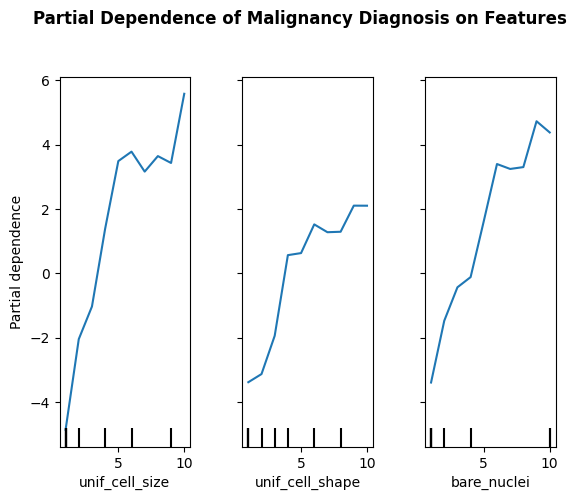

In [32]:
from sklearn.inspection import PartialDependenceDisplay
import matplotlib.pyplot as plt

# Crear la visualización de dependencias parciales solo para características individuales
pdp = PartialDependenceDisplay.from_estimator(
    model, 
    X_train, 
    features=[
        "unif_cell_size", 
        "unif_cell_shape", 
        "bare_nuclei"
    ],
    grid_resolution=30
)

# Ajustar el espaciado de los subplots
pdp.figure_.subplots_adjust(wspace=0.4, hspace=0.4)

# Configurar el título principal
plt.suptitle("Partial Dependence of Malignancy Diagnosis on Features", 
             y=1.02, fontsize=12, fontweight='bold')

# Mostrar los gráficos
plt.show()

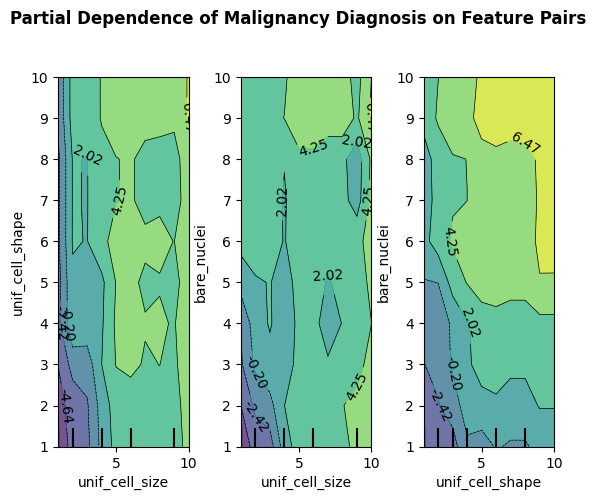

In [33]:
from sklearn.inspection import PartialDependenceDisplay
import matplotlib.pyplot as plt

# Crear la visualización de dependencias parciales solo para combinaciones de dos variables
pdp = PartialDependenceDisplay.from_estimator(
    model, 
    X_train, 
    features=[
        ("unif_cell_size", "unif_cell_shape"), 
        ("unif_cell_size", "bare_nuclei"), 
        ("unif_cell_shape", "bare_nuclei")
    ],
    grid_resolution=30
)

# Ajustar el espaciado de los subplots
pdp.figure_.subplots_adjust(wspace=0.4, hspace=0.4)

# Configurar el título principal
plt.suptitle("Partial Dependence of Malignancy Diagnosis on Feature Pairs", 
             y=1.02, fontsize=12, fontweight='bold')

# Mostrar los gráficos
plt.show()

In [34]:
# ! pip install pycebox

In [35]:
X_test

,unif_cell_size,unif_cell_shape,bare_nuclei
154,1,1,1.0
687,1,1,1.0
80,2,2,1.0
269,1,1,1.0
136,1,1,1.0
...,...,...,...
188,8,4,8.0
328,10,3,4.0
310,1,1,1.0
237,8,8,2.0


In [36]:
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Crear el DataFrame ICE para la característica 'unif_cell_size'
ice_df = ice(X_test, column='unif_cell_size', predict=model.predict)

c:\Users\tavin\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


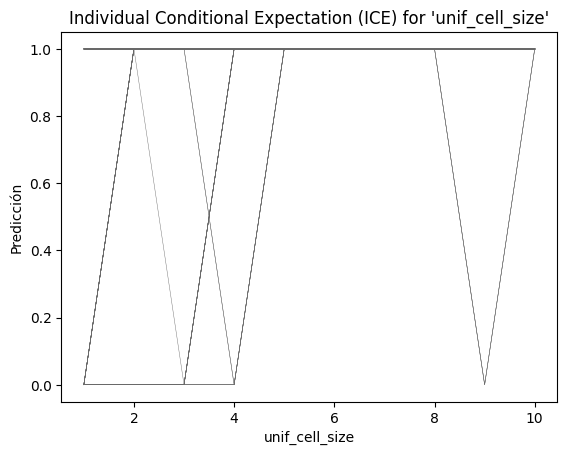

In [37]:
# Crear el gráfico ICE
ice_plot(ice_df, c='dimgray', linewidth=0.3)
plt.ylabel('Predicción')
plt.xlabel('unif_cell_size')
plt.title("Individual Conditional Expectation (ICE) for 'unif_cell_size'")
plt.show()

# Lime para datos tabulares

In [38]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_breast_cancer
from lime import lime_tabular
import pandas as pd

# Cargar el conjunto de datos de cáncer de mama
data = load_breast_cancer()
X = pd.DataFrame(data.data, columns=data.feature_names)
y = data.target

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Configurar el clasificador
clf = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=10, min_samples_split=5)
clf.fit(X_train, y_train)

# Crear un explainer de LIME para datos tabulares
explainer = lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_train.columns,
    class_names=data.target_names,
    mode='classification'
)

# Función centralizada para predicción con nombres de columnas
def predict_proba_fixed(input_data):
    """Convierte cualquier entrada en un DataFrame con nombres de columnas antes de predecir."""
    input_df = pd.DataFrame(input_data, columns=X_train.columns)
    return clf.predict_proba(input_df)

# Explicar las primeras 20 instancias del conjunto de prueba
num_instances = min(20, X_test.shape[0])  # No exceder el tamaño del conjunto de prueba
explanations = []

for i in range(num_instances):
    # Obtener la explicación de LIME usando la función de predicción fija
    exp = explainer.explain_instance(
        X_test.iloc[i].values,
        predict_proba_fixed,  # Asegurar nombres de columnas en cada predicción
        num_features=5
    )
    explanations.append(exp)

    # Mostrar las probabilidades de la instancia seleccionada
    probs = predict_proba_fixed(X_test.iloc[i].to_numpy().reshape(1, -1))  # Usar la función centralizada
    print(f"\nProbabilidades para la instancia {i}:")
    print(f"Benigno (0): {probs[0][0]:.4f}")
    print(f"Maligno (1): {probs[0][1]:.4f}")
    
    # Mostrar las explicaciones de LIME para cada instancia
    print(f"Explicación de LIME para la instancia {i}:")
    exp.show_in_notebook()



Probabilidades para la instancia 0:
Benigno (0): 0.0225
Maligno (1): 0.9775
Explicación de LIME para la instancia 0:



Probabilidades para la instancia 1:
Benigno (0): 0.9900
Maligno (1): 0.0100
Explicación de LIME para la instancia 1:



Probabilidades para la instancia 2:
Benigno (0): 1.0000
Maligno (1): 0.0000
Explicación de LIME para la instancia 2:



Probabilidades para la instancia 3:
Benigno (0): 0.0100
Maligno (1): 0.9900
Explicación de LIME para la instancia 3:



Probabilidades para la instancia 4:
Benigno (0): 0.0000
Maligno (1): 1.0000
Explicación de LIME para la instancia 4:



Probabilidades para la instancia 5:
Benigno (0): 1.0000
Maligno (1): 0.0000
Explicación de LIME para la instancia 5:



Probabilidades para la instancia 6:
Benigno (0): 1.0000
Maligno (1): 0.0000
Explicación de LIME para la instancia 6:



Probabilidades para la instancia 7:
Benigno (0): 0.8920
Maligno (1): 0.1080
Explicación de LIME para la instancia 7:



Probabilidades para la instancia 8:
Benigno (0): 0.7518
Maligno (1): 0.2482
Explicación de LIME para la instancia 8:



Probabilidades para la instancia 9:
Benigno (0): 0.0475
Maligno (1): 0.9525
Explicación de LIME para la instancia 9:



Probabilidades para la instancia 10:
Benigno (0): 0.0358
Maligno (1): 0.9642
Explicación de LIME para la instancia 10:



Probabilidades para la instancia 11:
Benigno (0): 0.9983
Maligno (1): 0.0017
Explicación de LIME para la instancia 11:



Probabilidades para la instancia 12:
Benigno (0): 0.0838
Maligno (1): 0.9163
Explicación de LIME para la instancia 12:



Probabilidades para la instancia 13:
Benigno (0): 0.8626
Maligno (1): 0.1374
Explicación de LIME para la instancia 13:



Probabilidades para la instancia 14:
Benigno (0): 0.0175
Maligno (1): 0.9825
Explicación de LIME para la instancia 14:



Probabilidades para la instancia 15:
Benigno (0): 0.9900
Maligno (1): 0.0100
Explicación de LIME para la instancia 15:



Probabilidades para la instancia 16:
Benigno (0): 0.0604
Maligno (1): 0.9396
Explicación de LIME para la instancia 16:



Probabilidades para la instancia 17:
Benigno (0): 0.0000
Maligno (1): 1.0000
Explicación de LIME para la instancia 17:



Probabilidades para la instancia 18:
Benigno (0): 0.0000
Maligno (1): 1.0000
Explicación de LIME para la instancia 18:



Probabilidades para la instancia 19:
Benigno (0): 1.0000
Maligno (1): 0.0000
Explicación de LIME para la instancia 19:


In [39]:
# Predecir el resultado de la instancia i asegurando que los nombres de columnas estén presentes
prediction = clf.predict(pd.DataFrame([X_test.iloc[i].values], columns=X_test.columns))[0]

# Imprimir la predicción en términos de las clases del conjunto de datos
print("Predicción del modelo para la instancia:", data.target_names[prediction])

Predicción del modelo para la instancia: malignant


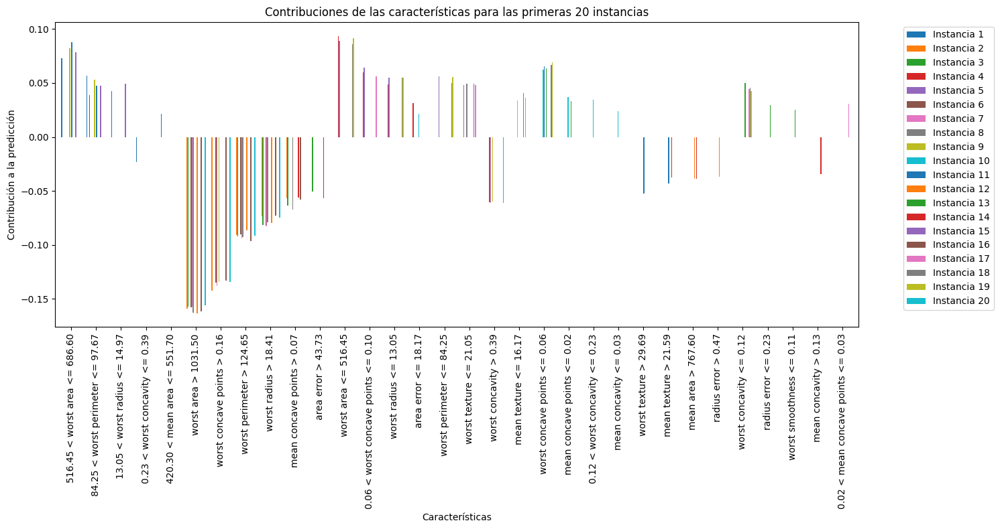

In [40]:
import matplotlib.pyplot as plt

# Extraer las contribuciones de LIME para cada instancia
lime_results = []
for i, exp in enumerate(explanations):
    contribs = dict(exp.as_list())
    lime_results.append(contribs)

# Convertir los resultados a un DataFrame
lime_df = pd.DataFrame(lime_results).fillna(0)  # Rellena con 0 si alguna característica falta

# Crear el gráfico de barras agrupado
lime_df.T.plot(kind='bar', figsize=(15, 8), width=0.8)
plt.title('Contribuciones de las características para las primeras 20 instancias')
plt.xlabel('Características')
plt.ylabel('Contribución a la predicción')
plt.legend([f'Instancia {i+1}' for i in range(lime_df.shape[0])], bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [41]:
lime_explanations_summary = []

for i, exp in enumerate(explanations):
    exp_list = exp.as_list()
    for feature, contribution in exp_list:
        lime_explanations_summary.append({
            "Instancia": i + 1,
            "Característica": feature,
            "Contribución": contribution
        })

lime_summary_df = pd.DataFrame(lime_explanations_summary)
print(lime_summary_df)

    Instancia                    Característica  Contribución
0           1     516.45 < worst area <= 686.60      0.072647
1           1  84.25 < worst perimeter <= 97.67      0.056572
2           1     13.05 < worst radius <= 14.97      0.042298
3           1    0.23 < worst concavity <= 0.39     -0.023014
4           1      420.30 < mean area <= 551.70      0.021550
..        ...                               ...           ...
95         20              worst area > 1031.50     -0.155735
96         20       worst concave points > 0.16     -0.134600
97         20          worst perimeter > 124.65     -0.091623
98         20              worst radius > 18.41     -0.074780
99         20            worst concavity > 0.39     -0.061013

[100 rows x 3 columns]


In [42]:
clf.predict_proba(X_test.iloc[i].values.reshape(1, -1))

c:\Users\tavin\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


array([[1., 0.]])

In [43]:
# Mostrar la explicación
exp.show_in_notebook(show_table=True)

In [44]:
X_test.iloc[i]

mean radius                  20.550000
mean texture                 20.860000
mean perimeter              137.800000
mean area                  1308.000000
mean smoothness               0.104600
mean compactness              0.173900
mean concavity                0.208500
mean concave points           0.132200
mean symmetry                 0.212700
mean fractal dimension        0.062510
radius error                  0.698600
texture error                 0.990100
perimeter error               4.706000
area error                   87.780000
smoothness error              0.004578
compactness error             0.026160
concavity error               0.040050
concave points error          0.014210
symmetry error                0.019480
fractal dimension error       0.002689
worst radius                 24.300000
worst texture                25.480000
worst perimeter             160.200000
worst area                 1809.000000
worst smoothness              0.126800
worst compactness        

In [45]:
exp.as_list()

[('worst area > 1031.50', -0.1557349627822321),
 ('worst concave points > 0.16', -0.13460020614109908),
 ('worst perimeter > 124.65', -0.09162305563568705),
 ('worst radius > 18.41', -0.07478044797627811),
 ('worst concavity > 0.39', -0.06101341846449879)]

In [46]:
from lime import lime_tabular
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_breast_cancer
import pandas as pd

# Cargar el conjunto de datos de cáncer de mama
data = load_breast_cancer()
X = pd.DataFrame(data.data, columns=data.feature_names)
y = data.target

# Dividir los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar un modelo RandomForestClassifier
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Crear un objeto explicador LIME
explainer = lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_train.columns.values.tolist(),
    class_names=['benigno', 'maligno'],
    verbose=True,
    mode='classification'
)

# Explicar las predicciones para las primeras 20 instancias
for i in range(20):
    # Seleccionar la instancia como un DataFrame
    instance = pd.DataFrame([X_test.iloc[i].values], columns=X_test.columns)
    
    # Explicación LIME
    exp = explainer.explain_instance(
        X_test.iloc[i].values,  # Valores NumPy para LIME
        lambda x: model.predict_proba(pd.DataFrame(x, columns=X_train.columns)),  # Predicción con nombres de columnas
        num_features=5
    )
    
    # Resultados de la explicación
    intercept = exp.intercept[1]  # Intercepto para la clase 'Maligno'
    prediction_local = exp.local_pred  # Predicción local para la instancia
    
    # Imprimir resultados
    print(f"Instance {i} prediction: {model.predict(instance)}")
    print(f"Intercept: {intercept}")
    print(f"Prediction_local: {prediction_local}")
    print("-" * 50)



Intercept 0.5110247392897173
Prediction_local [0.72741186]
Right: 0.97
Instance 0 prediction: [1]
Intercept: 0.5110247392897173
Prediction_local: [0.72741186]
--------------------------------------------------
Intercept 0.6999373532437776
Prediction_local [0.17103525]
Right: 0.0
Instance 1 prediction: [0]
Intercept: 0.6999373532437776
Prediction_local: [0.17103525]
--------------------------------------------------
Intercept 0.6788575275863568
Prediction_local [0.22673486]
Right: 0.0
Instance 2 prediction: [0]
Intercept: 0.6788575275863568
Prediction_local: [0.22673486]
--------------------------------------------------
Intercept 0.5040404097783592
Prediction_local [0.76589784]
Right: 0.99
Instance 3 prediction: [1]
Intercept: 0.5040404097783592
Prediction_local: [0.76589784]
--------------------------------------------------
Intercept 0.4920184041543997
Prediction_local [0.79481075]
Right: 1.0
Instance 4 prediction: [1]
Intercept: 0.4920184041543997
Prediction_local: [0.79481075]
----

# SHAP

In [47]:
# ! pip install shap

In [48]:
import shap

explainer = shap.TreeExplainer(clf)
shap_values = explainer.shap_values(X_test)
shap.initjs()
shap.force_plot(explainer.expected_value[0], shap_values[i,:,0], X_test.iloc[i].values, feature_names=data.feature_names)

In [49]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[i,:,1], X_test.iloc[i].values, feature_names=data.feature_names)

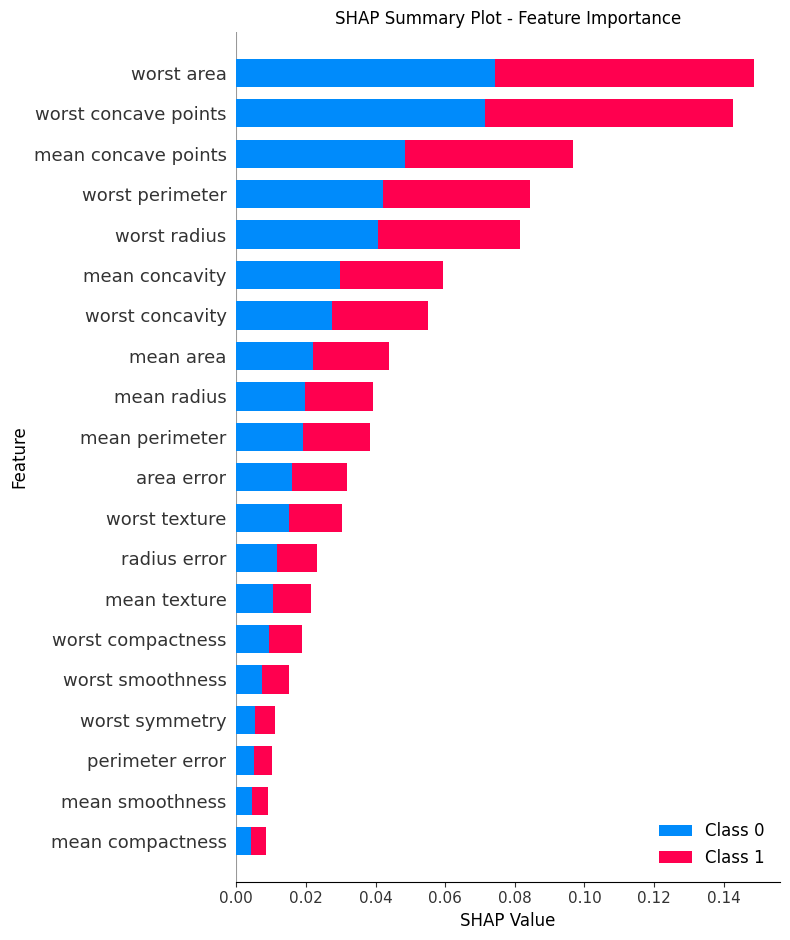

In [50]:
# Create a summary plot with the bar plot type
shap_values = explainer.shap_values(X_train)

# Bug en paquete shap, setiembre 2024
ensured_list_shap_values = [shap_values[:,:,i] for i in range(shap_values.shape[2])]
shap.summary_plot(ensured_list_shap_values, X_train, plot_type='bar', show=False)

#explainer = shap.Explainer(clf)
#shap_values = explainer(X_test)
#ax = shap.plots.bar(shap_values[:,:,0],show=False)


# Customize the plot appearance
plt.title("SHAP Summary Plot - Feature Importance")
plt.xlabel("SHAP Value", fontsize=12)
plt.ylabel("Feature", fontsize=12)
plt.tight_layout()
plt.show()

In [ ]:
explainer_a = shap.Explainer(clf)
shap_values_cat = explainer_a(X_test)

In [ ]:
shap_values_cat.shape

(114, 30, 2)

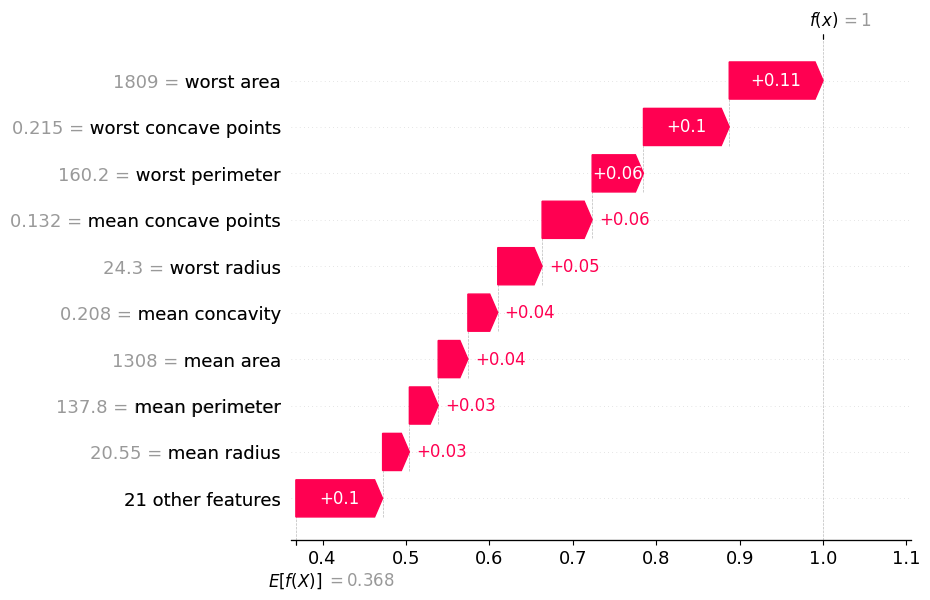

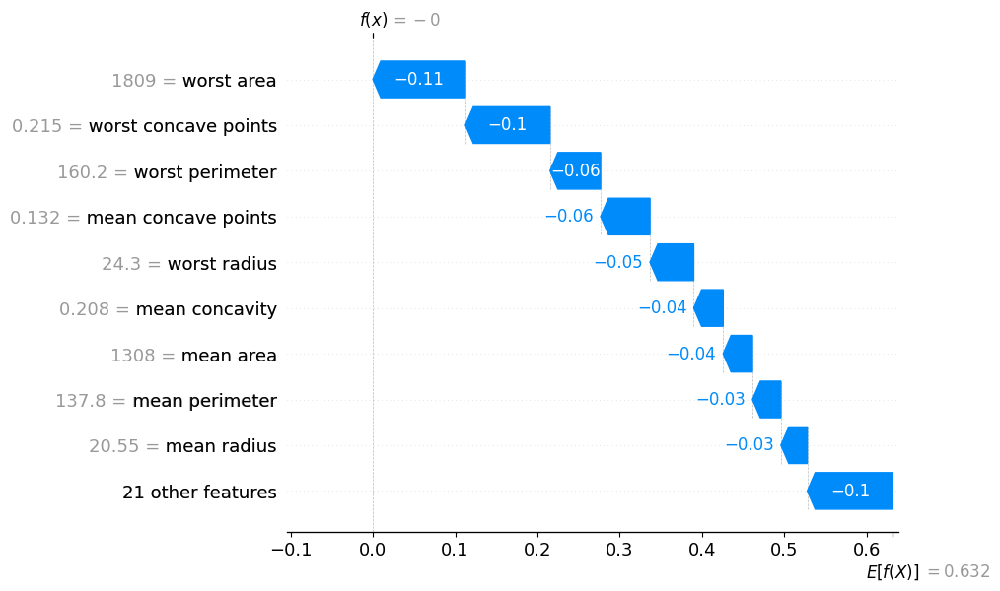

In [ ]:
shap.plots.waterfall(shap_values_cat[i,:,0])
shap.plots.waterfall(shap_values_cat[i,:,1])

In [ ]:
data = pd.read_csv('./bsd/breast-cancer-wisconsin.data', header=None)
data.columns=['Id number','Clump Thickness','Uniformity of Cell Size','Uniformity of Cell Shape','Marginal Adhesion','Single Epithelial Cell Size','Bare Nuclei','Bland Chromatin','Normal Nucleoli','Mitoses','Class']
data2 = data.apply(pd.to_numeric, errors='coerce') #Convert argument to numeric type and invalid parsing is set as NaN
data = data2.dropna() #Rewrrite previous data entry with new complete data 

#Patient Number is not required
del data['Id number']

# Display the first few records
data.head()

,Clump Thickness,Uniformity of Cell Size,Uniformity of Cell Shape,Marginal Adhesion,Single Epithelial Cell Size,Bare Nuclei,Bland Chromatin,Normal Nucleoli,Mitoses,Class
0,5,1,1,1,2,1.0,3,1,1,2
1,5,4,4,5,7,10.0,3,2,1,2
2,3,1,1,1,2,2.0,3,1,1,2
3,6,8,8,1,3,4.0,3,7,1,2
4,4,1,1,3,2,1.0,3,1,1,2


In [ ]:
from sklearn.ensemble import RandomForestClassifier
X_train, X_test, y_train, y_test = train_test_split(data.iloc[:, :9], # train for first 3 variables
                                                    data.iloc[:, 9], # test is the last variable
                                                    test_size=0.2, # 20% for testing
                                                    random_state = 123)

clf = RandomForestClassifier(random_state=0)
clf.fit(X_train, y_train)
print(f"Score: {clf.score(X_test, y_test)}")

Score: 0.9781021897810219
